In [2]:
from dateutil.parser import parse 
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

In [3]:
df = pd.read_csv('timeSeries.csv', parse_dates=['date'])
df.head()

,Unnamed: 0,testPositivityRatio,caseDensity_x,contactTracerCapacityRatio,infectionRate,infectionRateCI90,icuCapacityRatio,date,vaccinationsInitiatedRatio,vaccinationsCompletedRatio,...,icuBeds.currentUsageTotal,icuBeds.currentUsageCovid,vaccinesDistributed,vaccinationsInitiated,vaccinationsCompleted,vaccinationsAdditionalDose,vaccinesAdministered,overall,caseDensity_y,cdcTransmissionLevel
0,0,NaN,0.0,NaN,NaN,NaN,NaN,2020-04-09,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0
1,1,NaN,0.0,NaN,NaN,NaN,NaN,2020-04-10,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0
2,2,NaN,0.0,NaN,NaN,NaN,NaN,2020-04-11,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0
3,3,NaN,0.0,NaN,NaN,NaN,NaN,2020-04-12,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0
4,4,NaN,0.0,NaN,NaN,NaN,NaN,2020-04-13,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0


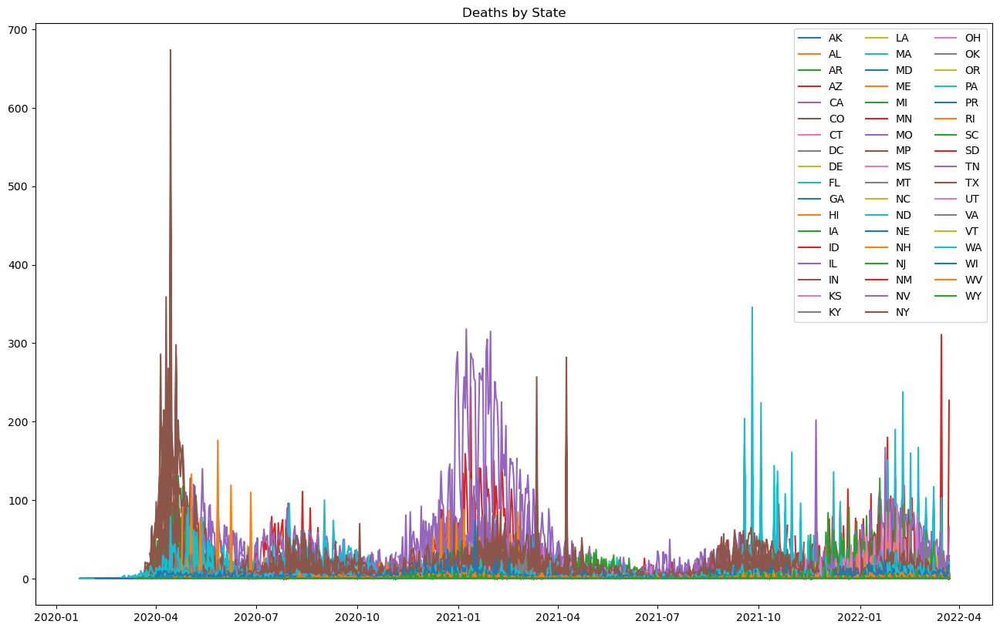

In [6]:

plt.figure(figsize=(16,10), dpi=100)   
for state in df['state'].unique():
    plt.plot(df[df['state'] == state]['date'], df[df['state'] == state]['newDeaths'], label= state)
plt.title('Deaths by State')
plt.legend(ncol=3);
plt.show()

In [23]:
df.iloc[1497390:1497400][['newDeaths','date']]

,newDeaths,date
1497390,89.0,2020-04-11
1497391,268.0,2020-04-12
1497392,0.0,2020-04-13
1497393,674.0,2020-04-14
1497394,190.0,2020-04-15
1497395,163.0,2020-04-16
1497396,107.0,2020-04-17
1497397,110.0,2020-04-18
1497398,284.0,2020-04-19
1497399,132.0,2020-04-20


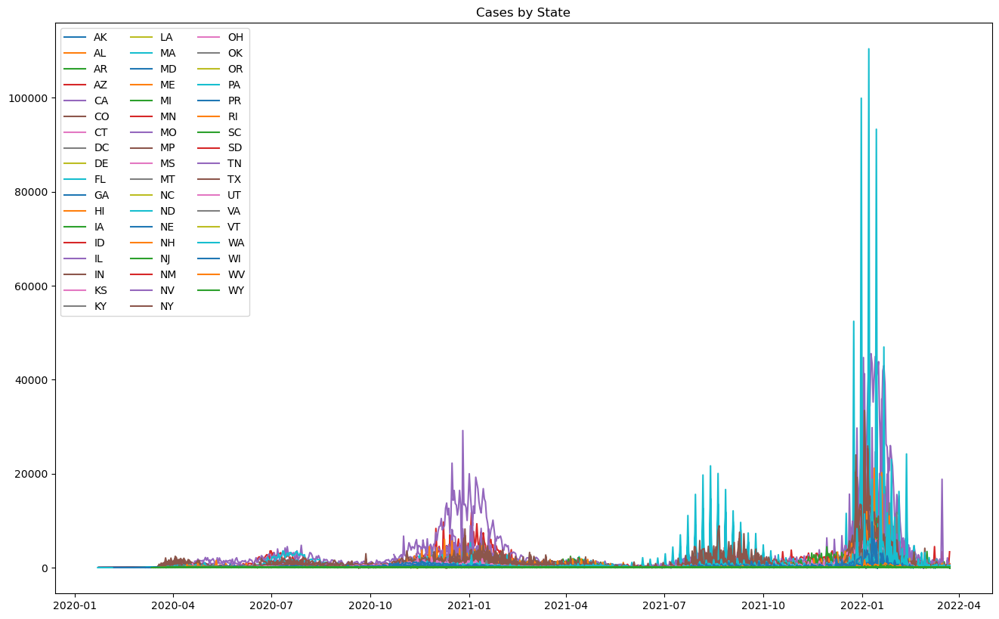

In [8]:
plt.figure(figsize=(16,10), dpi=100)
for state in df['state'].unique():
    plt.plot(df[df['state'] == state]['date'], df[df['state'] == state]['newCases'], label= state)
    plt.title('Cases by State')
plt.legend(ncol= 3);
plt.show()

In [19]:
df.iloc[272659:272669][['newCases']]

,newCases
272659,110441.0
272660,0.0
272661,0.0
272662,0.0
272663,0.0
272664,0.0
272665,0.0
272666,93321.0
272667,0.0
272668,0.0


In [5]:
df.columns

Index(['Unnamed: 0', 'testPositivityRatio', 'caseDensity_x',
       'contactTracerCapacityRatio', 'infectionRate', 'infectionRateCI90',
       'icuCapacityRatio', 'date', 'vaccinationsInitiatedRatio',
       'vaccinationsCompletedRatio', 'vaccinationsAdditionalDoseRatio', 'fips',
       'country', 'state', 'county', 'level', 'lat', 'locationId', 'long',
       'population', 'cases', 'deaths', 'positiveTests', 'negativeTests',
       'contactTracers', 'newCases', 'newDeaths',
       'vaccinesAdministeredDemographics', 'vaccinationsInitiatedDemographics',
       'hospitalBeds.capacity', 'hospitalBeds.currentUsageTotal',
       'hospitalBeds.currentUsageCovid', 'icuBeds.capacity',
       'icuBeds.currentUsageTotal', 'icuBeds.currentUsageCovid',
       'vaccinesDistributed', 'vaccinationsInitiated', 'vaccinationsCompleted',
       'vaccinationsAdditionalDose', 'vaccinesAdministered', 'overall',
       'caseDensity_y', 'cdcTransmissionLevel'],
      dtype='object')

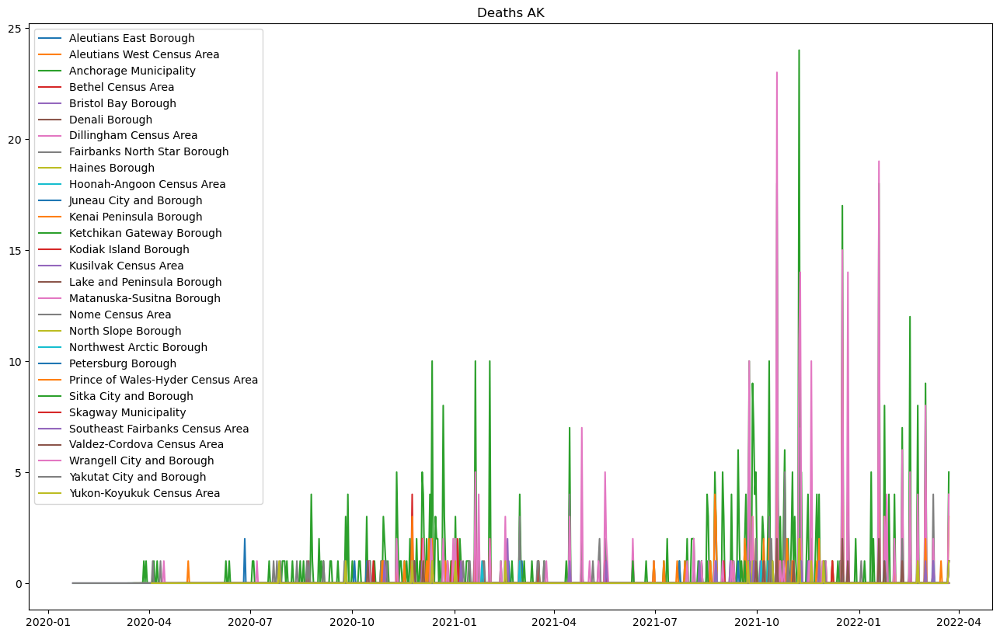

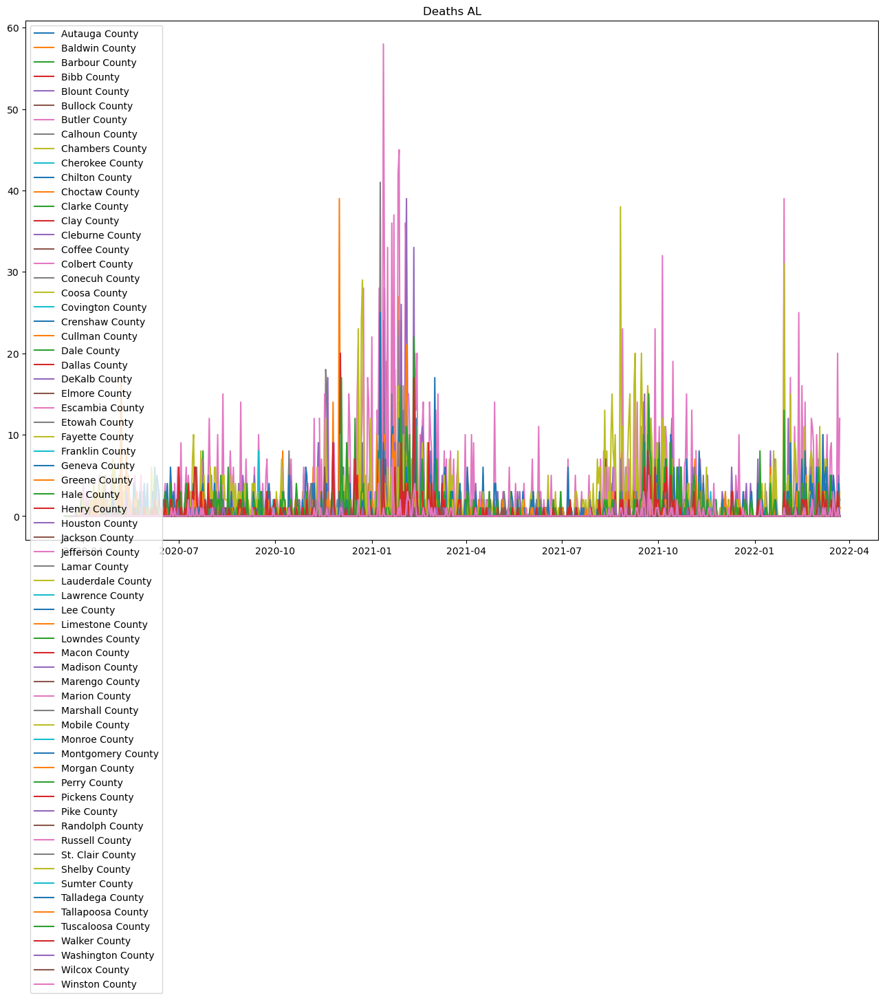

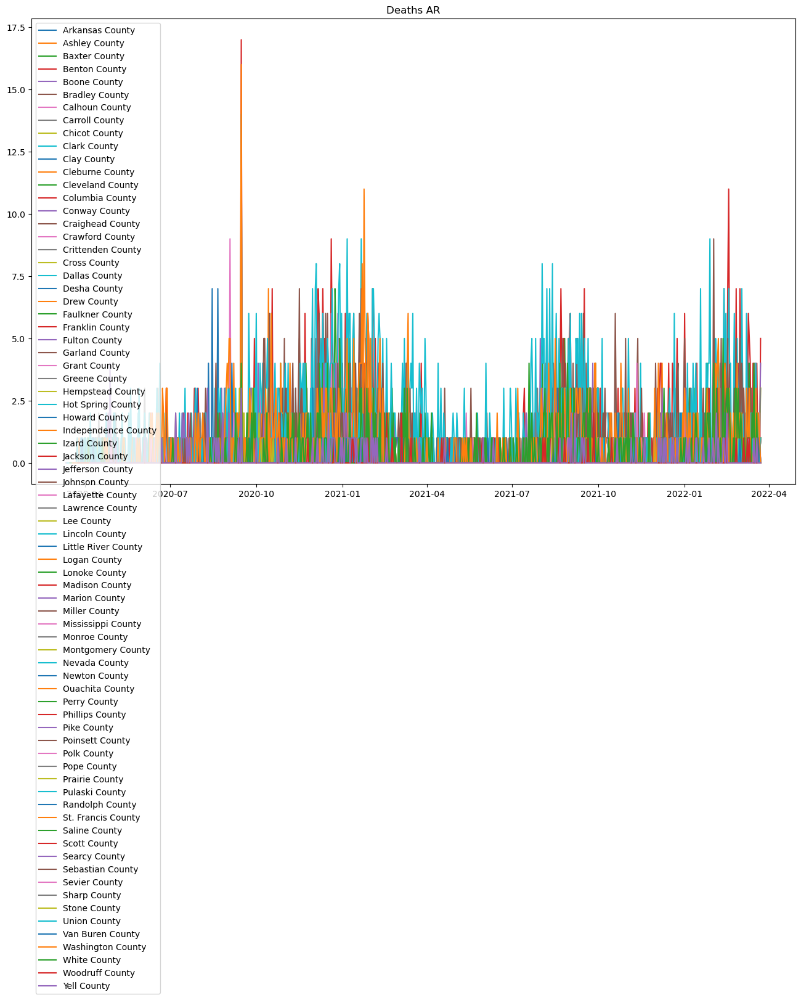

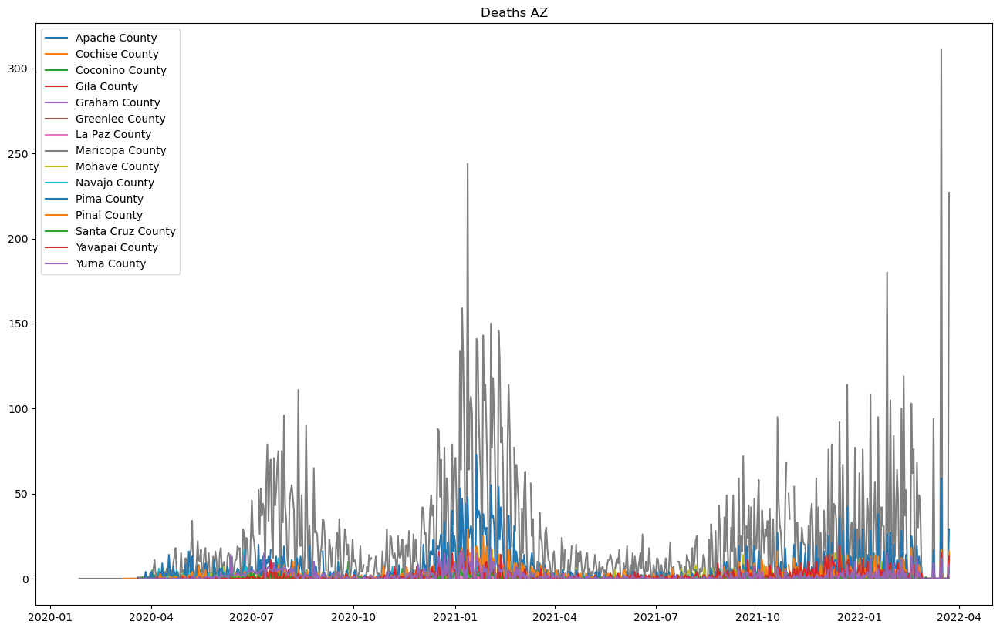

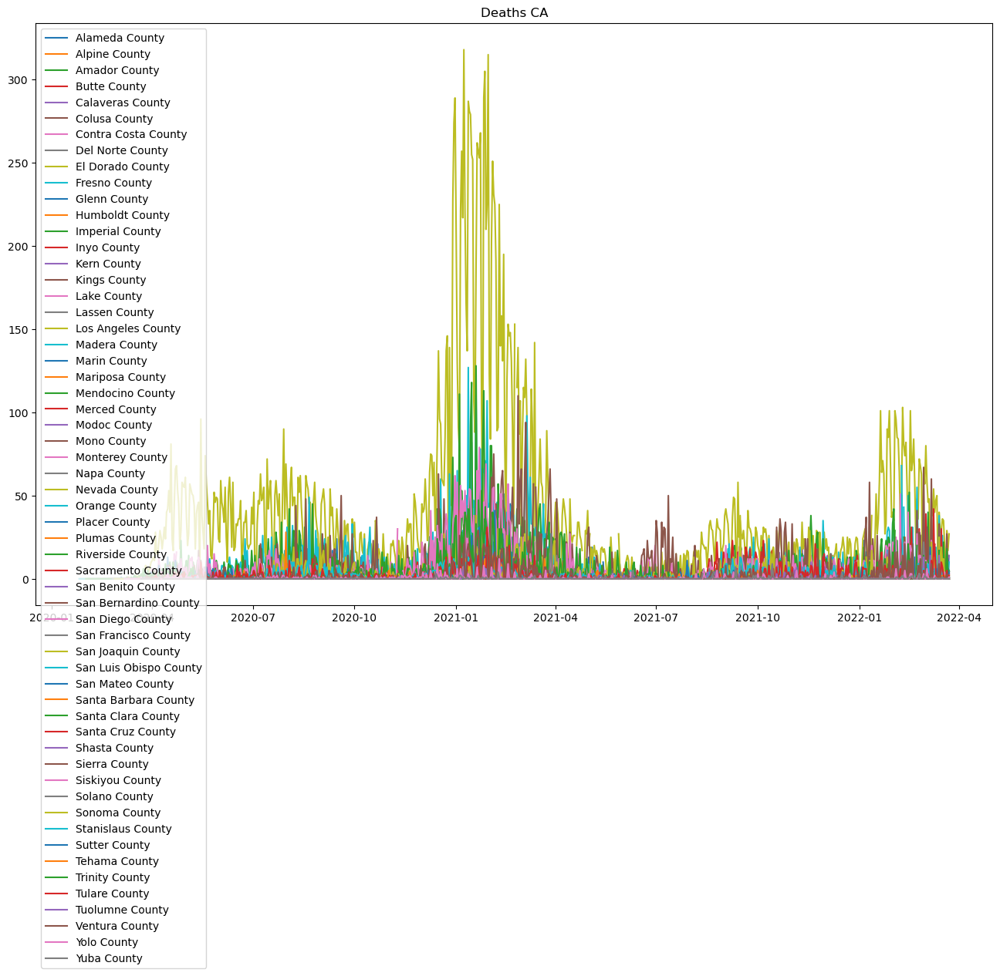

...

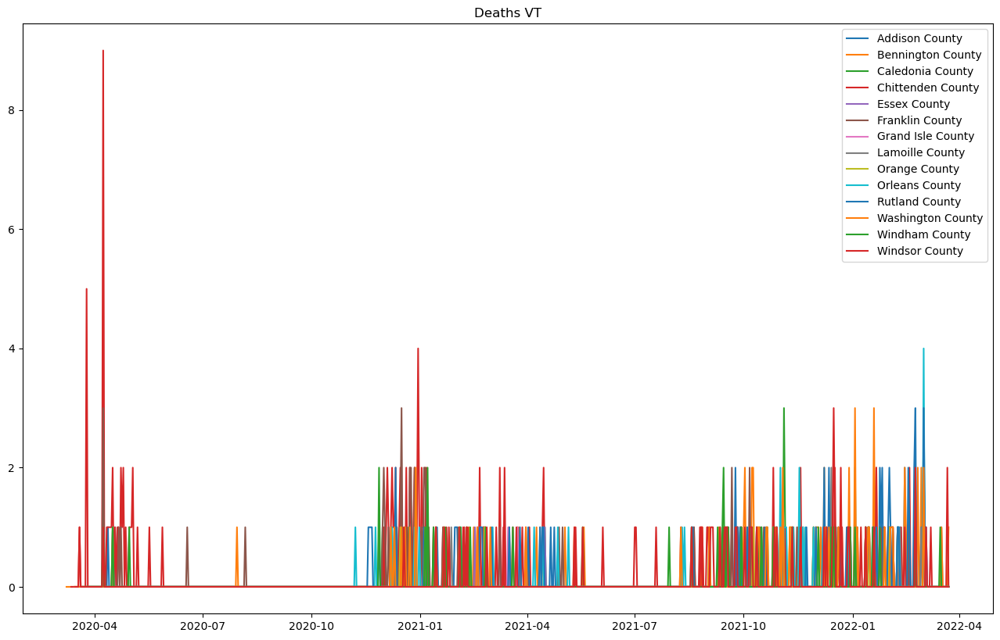

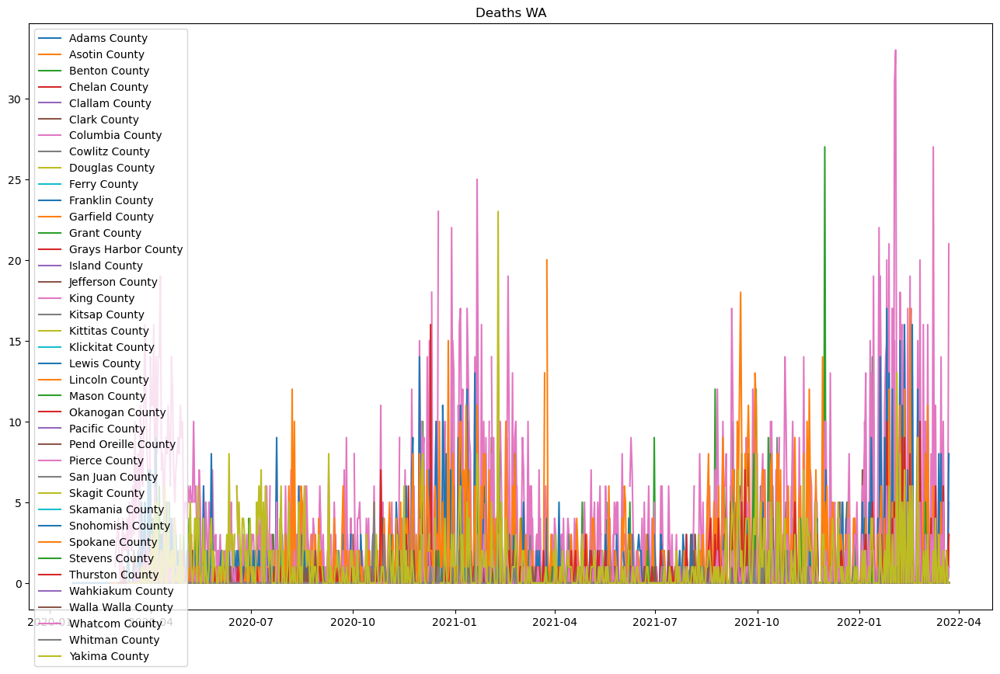

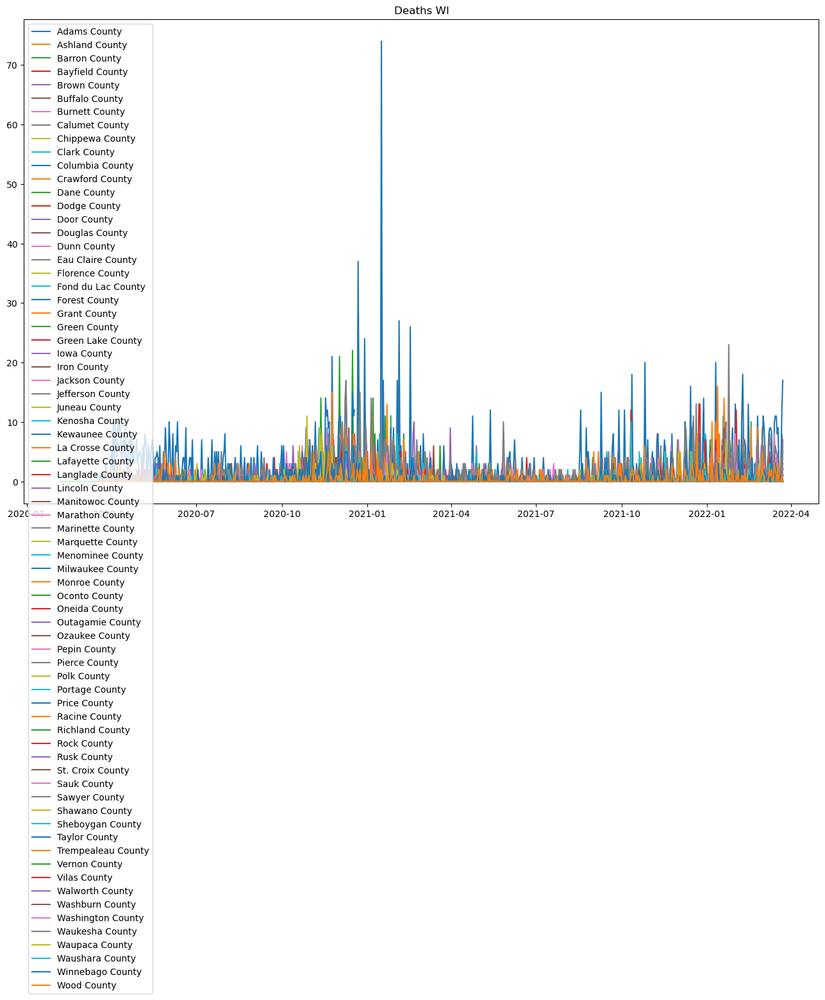

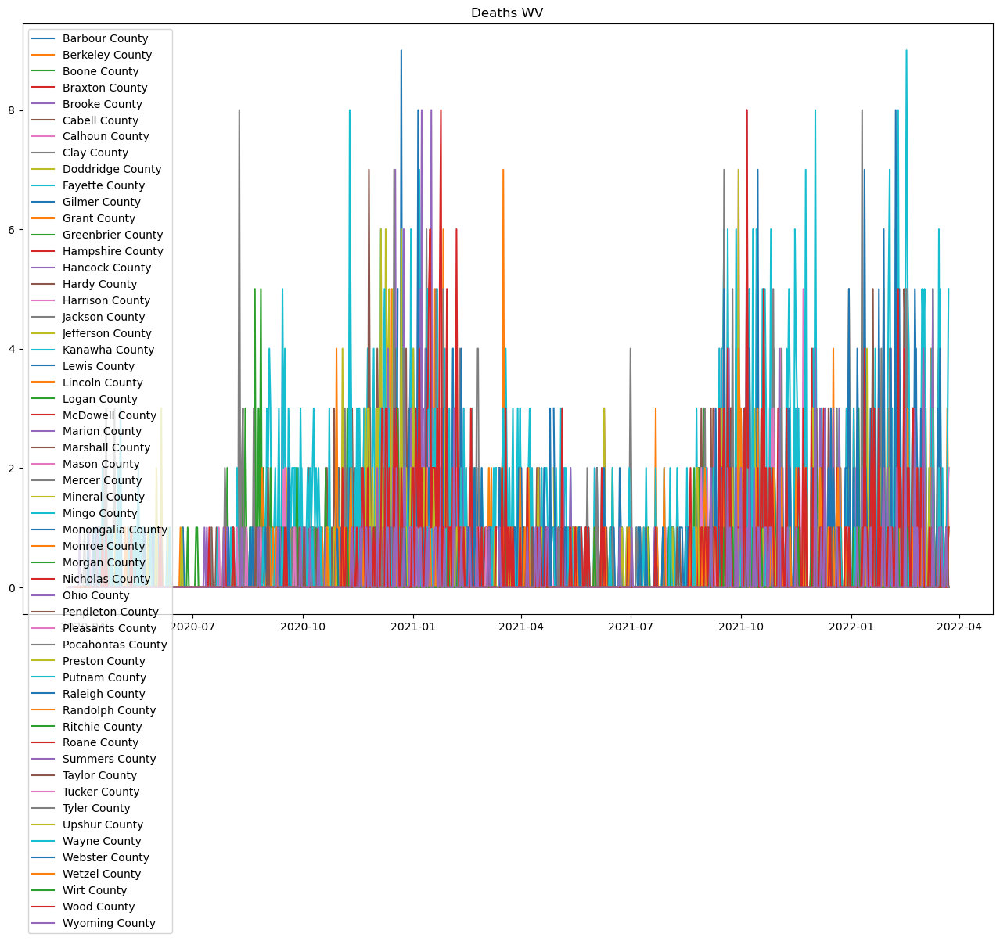

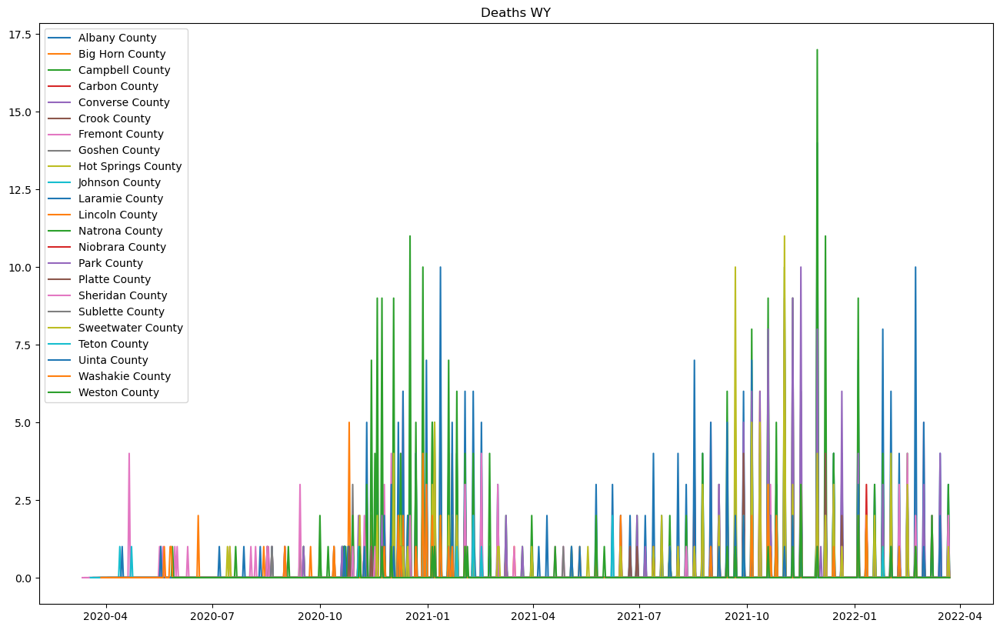

In [6]:

for state in df['state'].unique():
    state_df = df[df['state'] == state]
    plt.figure(figsize=(16,10), dpi=100)
    for county  in state_df['county'].unique():
           
        plt.plot(state_df[state_df['county'] == county]['date'], state_df[state_df['county'] == county]['newDeaths'], label= county)
        
    plt.title('Deaths '+ state)
    plt.legend();
    plt.show()

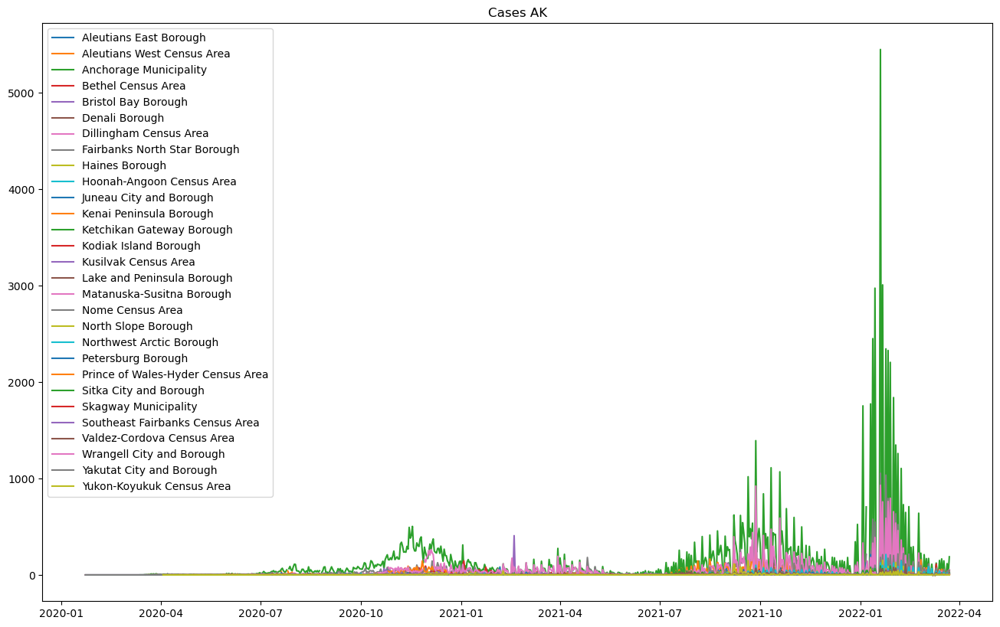

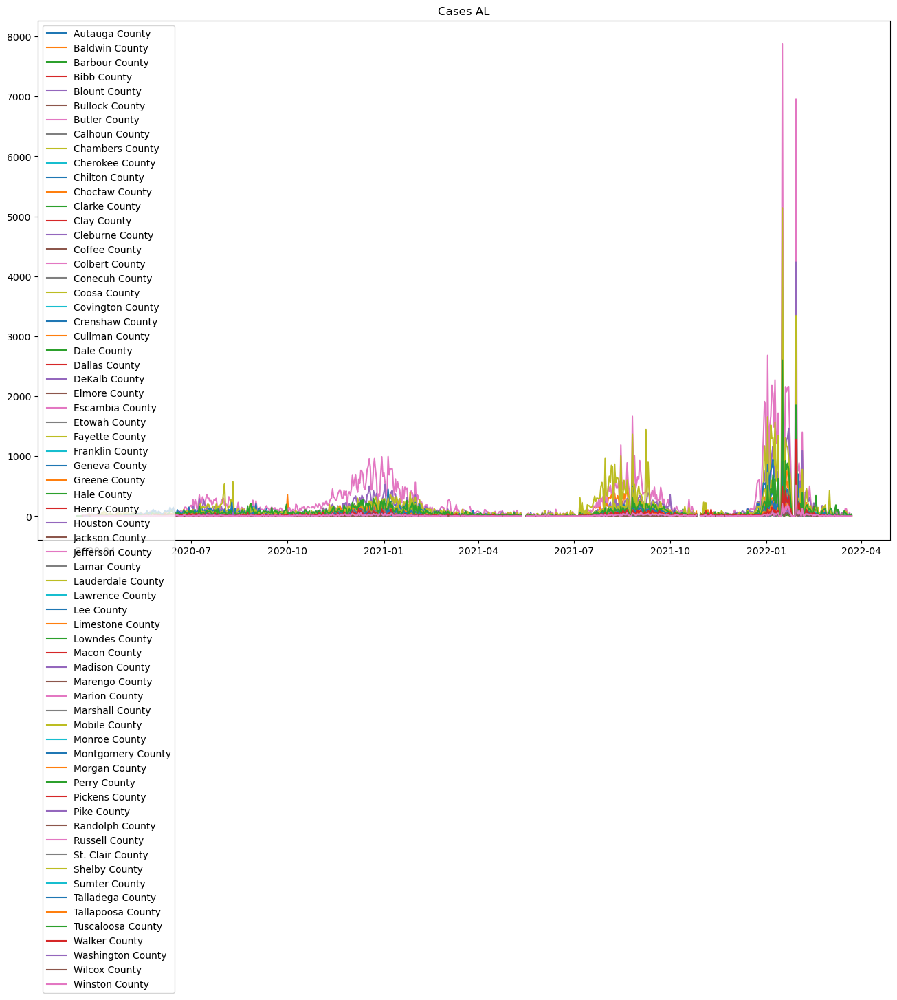

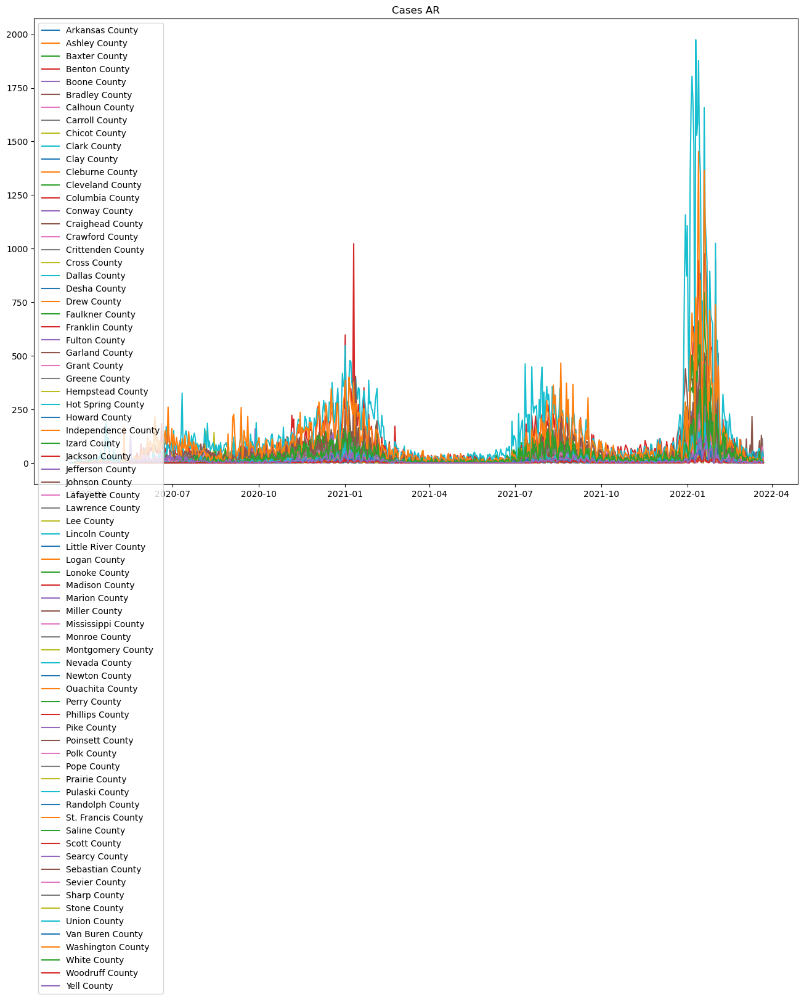

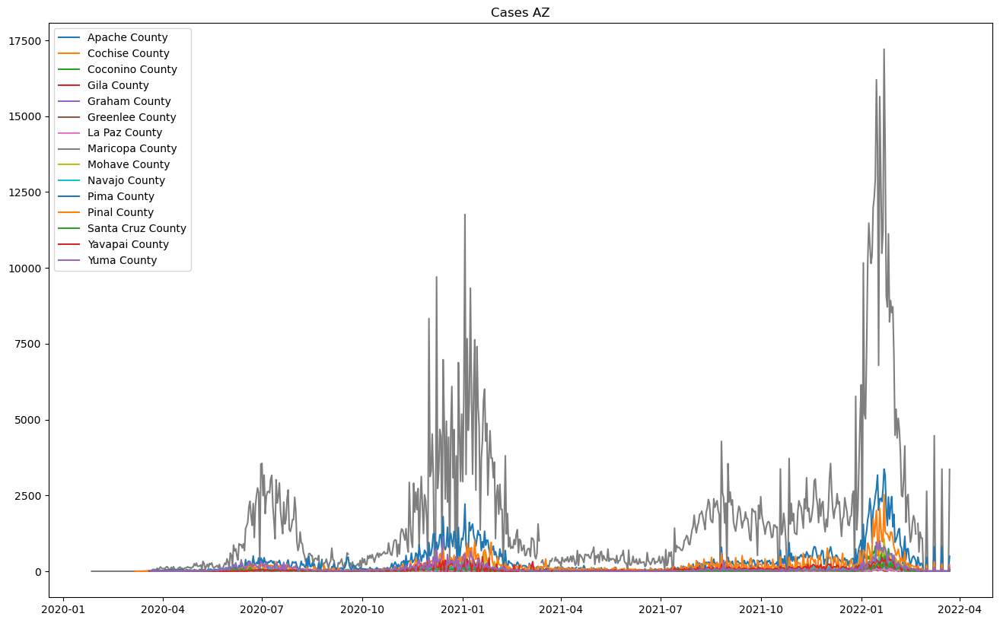

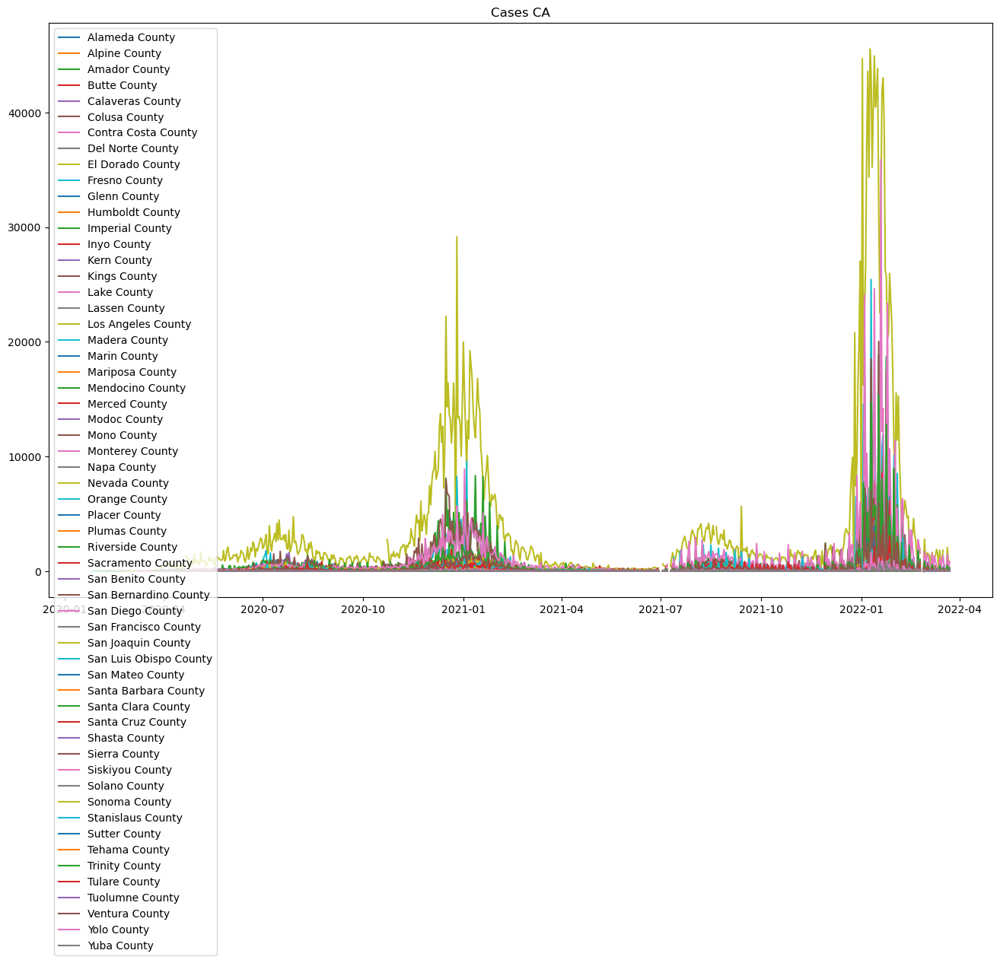

...

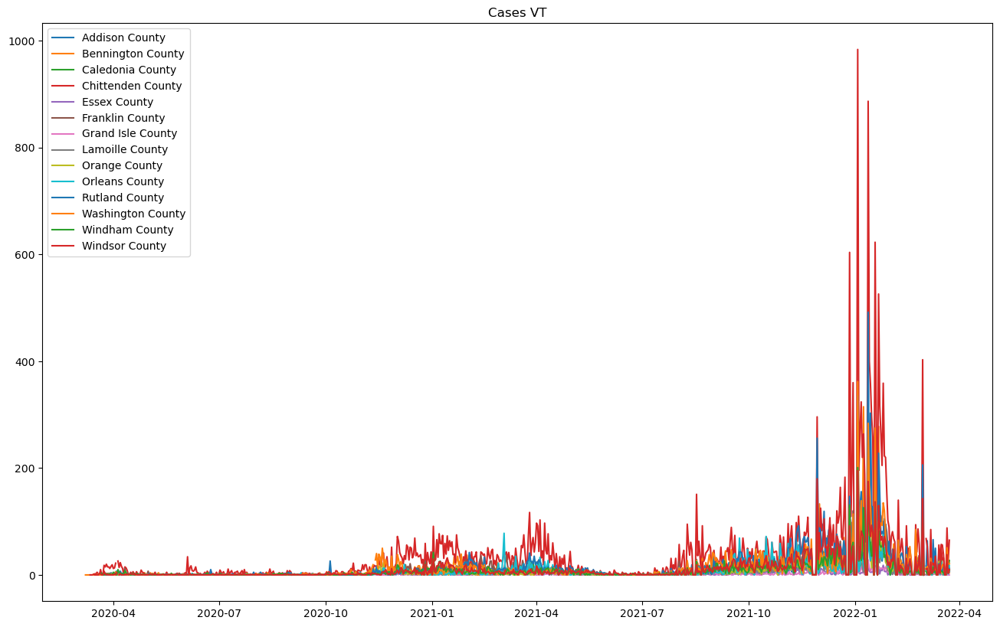

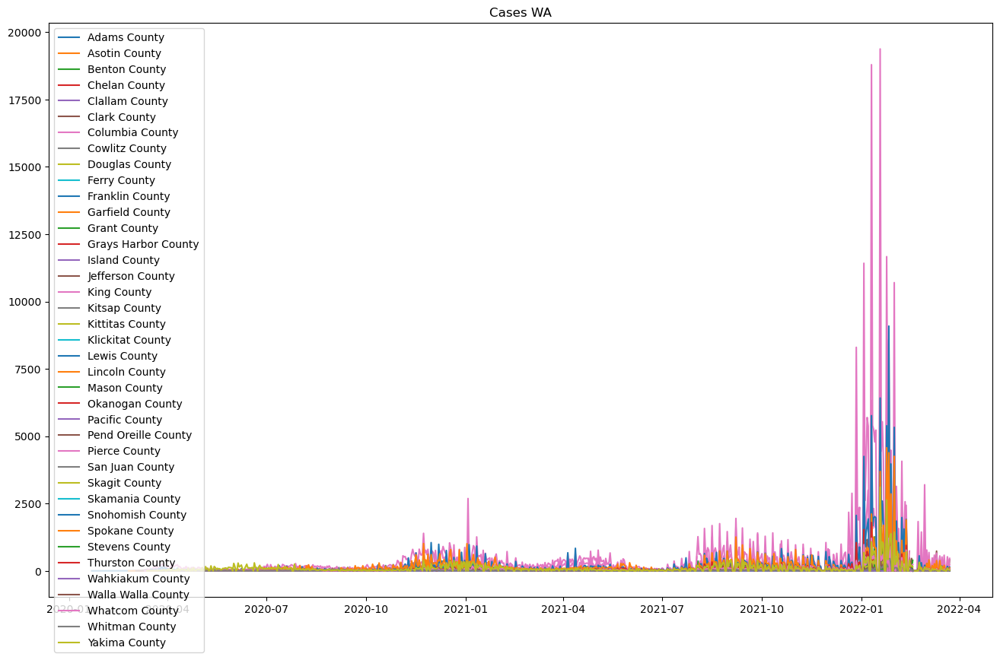

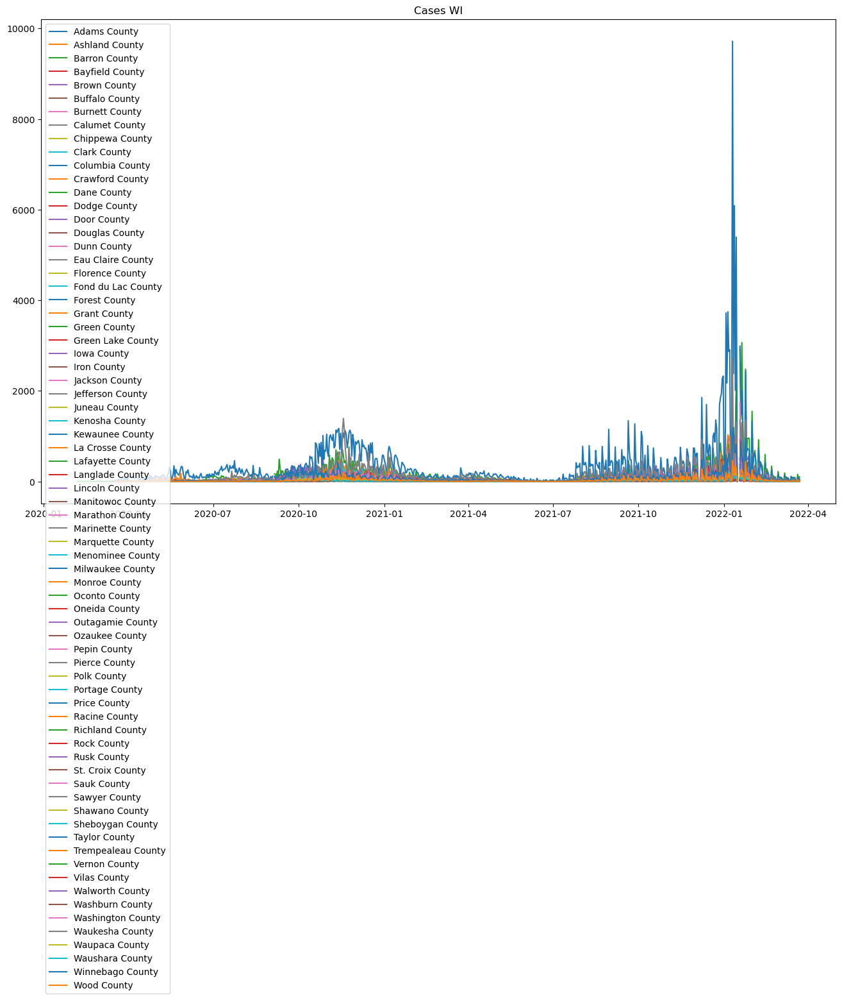

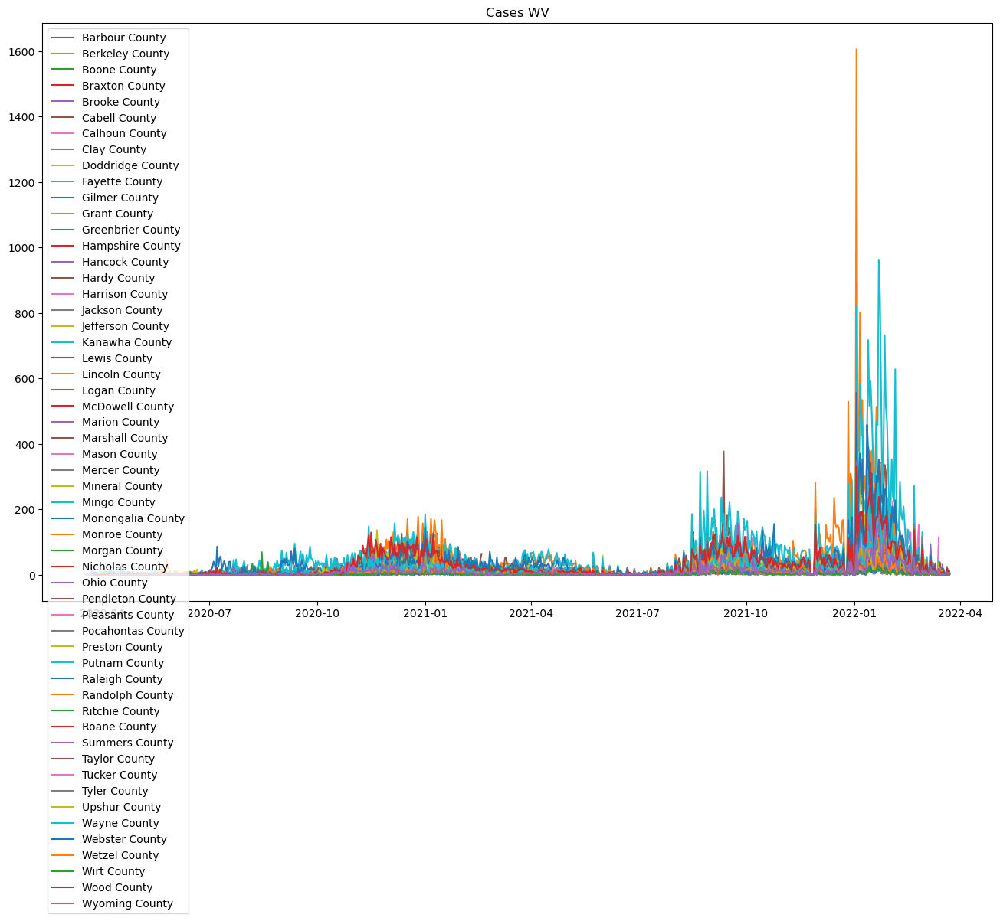

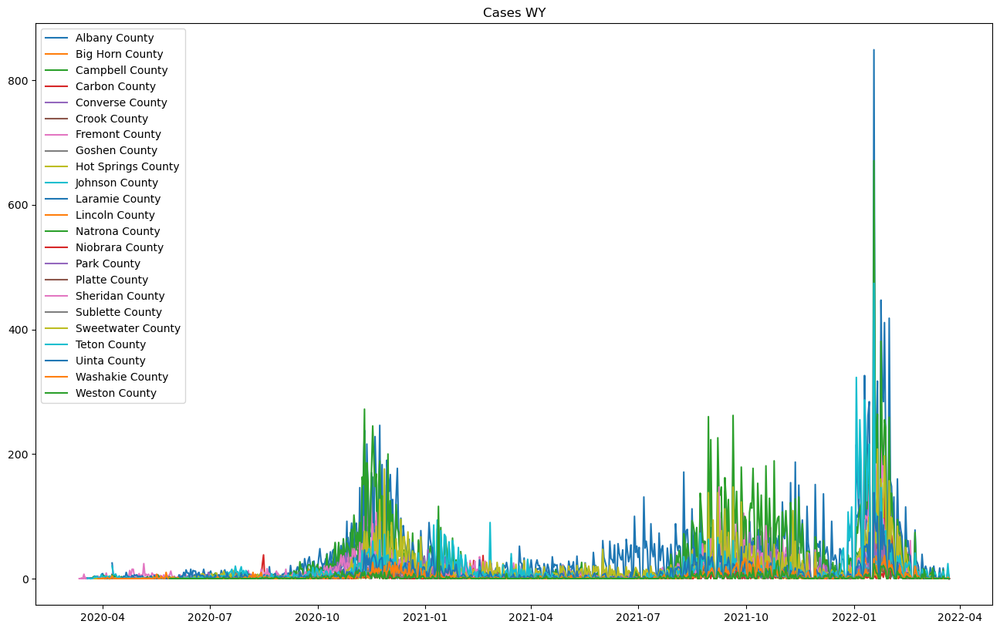

In [7]:
for state in df['state'].unique():
    state_df = df[df['state'] == state]
    plt.figure(figsize=(16,10), dpi=100)
    for county  in state_df['county'].unique():
           
        plt.plot(state_df[state_df['county'] == county]['date'], state_df[state_df['county'] == county]['newCases'], label= county)
        
    plt.title('Cases '+ state)
    plt.legend();
    plt.show()

In [ ]:
from statsmodels.tsa.stattools import adfuller, kpss

In [3]:
df = df[df['state'] != 'PR']

In [9]:
for state in df['state'].unique():
    state_df = df[df['state'] == state]
    print(state)
# ADF Test 
    result = adfuller(state_df.newDeaths.dropna().values, autolag='AIC')
    
    print(f'ADF Statistic: {result[0]}')
    print(f'p-value: {result[1]}')
    for key, value in result[4].items():
        print('Critial Values:')
        print(f'   {key}, {value}')

    # KPSS Test
    result = kpss(state_df.newDeaths.dropna().values, regression='c')
    print('\nKPSS Statistic: %f' % result[0])
    print('p-value: %f' % result[1])
    for key, value in result[3].items():
        print('Critial Values:')
        print(f'   {key}, {value}')

AK
ADF Statistic: -7.23975351336678
p-value: 1.897915685677165e-10
Critial Values:
   1%, -3.430672253130974
Critial Values:
   5%, -2.861682424672088
Critial Values:
   10%, -2.566845808741487

KPSS Statistic: 1.688822
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


AL
ADF Statistic: -18.982627163775415
p-value: 0.0
Critial Values:
   1%, -3.4304841933491015
Critial Values:
   5%, -2.8615993106703557
Critial Values:
   10%, -2.566801569114165

KPSS Statistic: 1.301125
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


AR
ADF Statistic: -16.912872144189187
p-value: 1.0075488791986276e-29
Critial Values:
   1%, -3.430470806349458
Critial Values:
   5%, -2.8615933940152667
Critial Values:
   10%, -2.566798419852783

KPSS Statistic: 0.878258
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


AZ
ADF Statistic: -8.202334565931501
p-value: 7.174945500214201e-13
Critial Values:
   1%, -3.4309468457314067
Critial Values:
   5%, -2.8618037728517667
Critial Values:
   10%, -2.5669104011605994

KPSS Statistic: 1.042149
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


CA
ADF Statistic: -14.821140216939094
p-value: 1.9628362512512058e-27
Critial Values:
   1%, -3.4305041181540887
Critial Values:
   5%, -2.861608116791249
Critial Values:
   10%, -2.566806256361758

KPSS Statistic: 0.571887
p-value: 0.025476
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)


CO
ADF Statistic: -17.26435020372186
p-value: 5.914293521456309e-30
Critial Values:
   1%, -3.430492061621432
Critial Values:
   5%, -2.8616027881999044
Critial Values:
   10%, -2.56680342010297

KPSS Statistic: 1.946038
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


CT
ADF Statistic: -9.133784704383322
p-value: 2.9731896718484515e-15
Critial Values:
   1%, -3.4314683199526126
Critial Values:
   5%, -2.862034192295842
Critial Values:
   10%, -2.567033056439477

KPSS Statistic: 1.689066
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


DC
ADF Statistic: -3.011285667054917
p-value: 0.03385381802107151
Critial Values:
   1%, -3.439376877165393
Critial Values:
   5%, -2.865523768488869
Critial Values:
   10%, -2.5688914082860164

KPSS Statistic: 0.845787
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


DE
ADF Statistic: -4.487798834078949
p-value: 0.0002068667314158942
Critial Values:
   1%, -3.4333532186762805
Critial Values:
   5%, -2.862866720471125
Critial Values:
   10%, -2.5674762791431696

KPSS Statistic: 0.497911
p-value: 0.042137
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)


FL
ADF Statistic: -17.231282654907346
p-value: 6.190370350924554e-30
Critial Values:
   1%, -3.4304840393139093
Critial Values:
   5%, -2.861599242591541
Critial Values:
   10%, -2.566801532877789

KPSS Statistic: 1.312398
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


GA
ADF Statistic: -21.95271632309489
p-value: 0.0
Critial Values:
   1%, -3.4304066014220385
Critial Values:
   5%, -2.861565016978837
Critial Values:
   10%, -2.5667833156559743

KPSS Statistic: 4.053671
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


HI
ADF Statistic: -4.589042698336627
p-value: 0.00013531161304976825
Critial Values:
   1%, -3.432277046455104
Critial Values:
   5%, -2.8623914576657032
Critial Values:
   10%, -2.5672232470994074

KPSS Statistic: 1.046755
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


IA
ADF Statistic: -17.240459601822412
p-value: 6.111911701095558e-30
Critial Values:
   1%, -3.430441989536347
Critial Values:
   5%, -2.8615806577516705
Critial Values:
   10%, -2.5667916407302473

KPSS Statistic: 1.484304
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


ID
ADF Statistic: -13.174196842268389
p-value: 1.2328479380467102e-24
Critial Values:
   1%, -3.430562146644378
Critial Values:
   5%, -2.861633763174791
Critial Values:
   10%, -2.5668199072605646

KPSS Statistic: 1.843312
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


IL
ADF Statistic: -18.71630221268188
p-value: 2.033621702723812e-30
Critial Values:
   1%, -3.430439032532546
Critial Values:
   5%, -2.8615793508277805
Critial Values:
   10%, -2.5667909450959576

KPSS Statistic: 0.979575
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


IN
ADF Statistic: -20.837582514683586
p-value: 0.0
Critial Values:
   1%, -3.4304476927215357
Critial Values:
   5%, -2.861583178417383
Critial Values:
   10%, -2.566792982401598

KPSS Statistic: 1.149948
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


KS
ADF Statistic: -16.976085368017866
p-value: 9.08417184201967e-30
Critial Values:
   1%, -3.4304391101795595
Critial Values:
   5%, -2.8615793851458924
Critial Values:
   10%, -2.566790963362401

KPSS Statistic: 1.317850
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


KY
ADF Statistic: -17.31775457966487
p-value: 5.5050852199585485e-30
Critial Values:
   1%, -3.43042606629285
Critial Values:
   5%, -2.8615736200492563
Critial Values:
   10%, -2.5667878947863096

KPSS Statistic: 1.049117
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


LA
ADF Statistic: -19.244164723339388
p-value: 0.0
Critial Values:
   1%, -3.4304899725887306
Critial Values:
   5%, -2.8616018649138804
Critial Values:
   10%, -2.5668029286642593

KPSS Statistic: 0.668780
p-value: 0.016384
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)


MA
ADF Statistic: -9.957335900738839
p-value: 2.424575967798936e-17
Critial Values:
   1%, -3.4309836265449083
Critial Values:
   5%, -2.8618200262063183
Critial Values:
   10%, -2.5669190528054657

KPSS Statistic: 0.882323
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


MD
ADF Statistic: -12.82330035941568
p-value: 6.088114267809389e-24
Critial Values:
   1%, -3.4307225792700846
Critial Values:
   5%, -2.861704665678964
Critial Values:
   10%, -2.566857647261052

KPSS Statistic: 0.470942
p-value: 0.048211
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)


ME
ADF Statistic: -9.662204908157564
p-value: 1.3441651547064153e-16
Critial Values:
   1%, -3.4309126931064253
Critial Values:
   5%, -2.861788680707392
Critial Values:
   10%, -2.56690236765788

KPSS Statistic: 0.688459
p-value: 0.014595
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)


MI
ADF Statistic: -19.96919525417711
p-value: 0.0
Critial Values:
   1%, -3.430459022070275
Critial Values:
   5%, -2.861588185692795
Critial Values:
   10%, -2.566795647619851

KPSS Statistic: 2.587965
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


MN
ADF Statistic: -19.201549567751293
p-value: 0.0
Critial Values:
   1%, -3.4304547504228338
Critial Values:
   5%, -2.8615862977387514
Critial Values:
   10%, -2.5667946427197563

KPSS Statistic: 0.459047
p-value: 0.051704
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)


MO
ADF Statistic: -17.165188162107384
p-value: 6.800473748976582e-30
Critial Values:
   1%, -3.430429760757499
Critial Values:
   5%, -2.861575252919868
Critial Values:
   10%, -2.566788763910533

KPSS Statistic: 0.763515
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


MP
ADF Statistic: -5.0251821445442335
p-value: 1.978241752285694e-05
Critial Values:
   1%, -3.4354892269437243
Critial Values:
   5%, -2.863809525815561
Critial Values:
   10%, -2.5679783161860823

KPSS Statistic: 0.261703
p-value: 0.100000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1910: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(


MS
ADF Statistic: -23.31265220475141
p-value: 0.0
Critial Values:
   1%, -3.4304594344007806
Critial Values:
   5%, -2.861588367931719
Critial Values:
   10%, -2.5667957446200718

KPSS Statistic: 1.386879
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


MT
ADF Statistic: -14.595011552005085
p-value: 4.2544031426794176e-27
Critial Values:
   1%, -3.430523527886579
Critial Values:
   5%, -2.861616695209877
Critial Values:
   10%, -2.5668108224197996

KPSS Statistic: 0.335177
p-value: 0.100000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1910: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(


NC
ADF Statistic: -21.47523464842347
p-value: 0.0
Critial Values:
   1%, -3.430440184263575
Critial Values:
   5%, -2.8615798598650883
Critial Values:
   10%, -2.566791216040405

KPSS Statistic: 0.217300
p-value: 0.100000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1910: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(


ND
ADF Statistic: -16.29788546635383
p-value: 3.288607823689228e-29
Critial Values:
   1%, -3.430526888753067
Critial Values:
   5%, -2.8616181805888803
Critial Values:
   10%, -2.5668116130474825

KPSS Statistic: 0.421377
p-value: 0.067941
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739
NE


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)


ADF Statistic: -16.527661376268345
p-value: 2.0371003188770974e-29
Critial Values:
   1%, -3.4304526264625257
Critial Values:
   5%, -2.861585359004029
Critial Values:
   10%, -2.566794143060201

KPSS Statistic: 0.510482
p-value: 0.039306
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)


NH
ADF Statistic: -7.943539705144133
p-value: 3.2654118579895184e-12
Critial Values:
   1%, -3.4312436604715635
Critial Values:
   5%, -2.8619349288473446
Critial Values:
   10%, -2.5669802163583566

KPSS Statistic: 1.150161
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


NJ
ADF Statistic: -13.493932937799212
p-value: 3.0679290887730014e-25
Critial Values:
   1%, -3.4307752253873107
Critial Values:
   5%, -2.8617279315677746
Critial Values:
   10%, -2.5668700313781887

KPSS Statistic: 0.286240
p-value: 0.100000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1910: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(


NM
ADF Statistic: -11.755691114309153
p-value: 1.1801600555159925e-21
Critial Values:
   1%, -3.4306284881165285
Critial Values:
   5%, -2.8616630829656606
Critial Values:
   10%, -2.56683551352467

KPSS Statistic: 1.685716
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


NV
ADF Statistic: -8.519331914560357
p-value: 1.1116346225909991e-13
Critial Values:
   1%, -3.4309033136438267
Critial Values:
   5%, -2.861784535865212
Critial Values:
   10%, -2.5669001613761906

KPSS Statistic: 2.653724
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


NY
ADF Statistic: -21.02547814121062
p-value: 0.0
Critial Values:
   1%, -3.430493316339815
Critial Values:
   5%, -2.8616033427452177
Critial Values:
   10%, -2.566803715271614

KPSS Statistic: 0.238924
p-value: 0.100000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1910: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(


OH
ADF Statistic: -20.24737340247994
p-value: 0.0
Critial Values:
   1%, -3.4304527554724276
Critial Values:
   5%, -2.86158541602304
Critial Values:
   10%, -2.566794173409659

KPSS Statistic: 0.328419
p-value: 0.100000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1910: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(


OK
ADF Statistic: -15.931962167743679
p-value: 7.711378344006392e-29
Critial Values:
   1%, -3.430474329724144
Critial Values:
   5%, -2.8615949512445162
Critial Values:
   10%, -2.5667992487196347

KPSS Statistic: 2.063255
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


OR
ADF Statistic: -12.243343238688267
p-value: 9.910426249832059e-23
Critial Values:
   1%, -3.430602976536837
Critial Values:
   5%, -2.8616518081323825
Critial Values:
   10%, -2.566829512171475

KPSS Statistic: 0.720573
p-value: 0.011675
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)


PA
ADF Statistic: -18.92343233674002
p-value: 0.0
Critial Values:
   1%, -3.4304838363089694
Critial Values:
   5%, -2.8615991528695988
Critial Values:
   10%, -2.566801485121406

KPSS Statistic: 0.400537
p-value: 0.076924
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)


RI
ADF Statistic: -4.039985273004438
p-value: 0.0012150179118505181
Critial Values:
   1%, -3.432169792577068
Critial Values:
   5%, -2.862344082457102
Critial Values:
   10%, -2.567198025902591

KPSS Statistic: 0.891471
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


SC
ADF Statistic: -16.718655974533064
p-value: 1.4146459334993088e-29
Critial Values:
   1%, -3.4305444921719594
Critial Values:
   5%, -2.8616259606231567
Critial Values:
   10%, -2.5668157541572945

KPSS Statistic: 0.838140
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


SD
ADF Statistic: -16.069152401940144
p-value: 5.531202492248085e-29
Critial Values:
   1%, -3.4304919875915356
Critial Values:
   5%, -2.8616027554810555
Critial Values:
   10%, -2.5668034026876616

KPSS Statistic: 0.925835
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


TN
ADF Statistic: -18.69466773950019
p-value: 2.038439180380773e-30
Critial Values:
   1%, -3.4304449783424324
Critial Values:
   5%, -2.861581978730074
Critial Values:
   10%, -2.5667923438455413

KPSS Statistic: 0.882988
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


TX
ADF Statistic: -24.90203038775902
p-value: 0.0
Critial Values:
   1%, -3.4303864015532866
Critial Values:
   5%, -2.8615560889948557
Critial Values:
   10%, -2.5667785635952725

KPSS Statistic: 0.852025
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


UT
ADF Statistic: -6.799925654513198
p-value: 2.2506360432368e-09
Critial Values:
   1%, -3.430667712685722
Critial Values:
   5%, -2.8616804180606388
Critial Values:
   10%, -2.5668447406586634

KPSS Statistic: 2.252995
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


VA
ADF Statistic: -25.437201412050236
p-value: 0.0
Critial Values:
   1%, -3.430418115272502
Critial Values:
   5%, -2.861570105869485
Critial Values:
   10%, -2.566786024303258

KPSS Statistic: 0.512802
p-value: 0.038783
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)


VT
ADF Statistic: -12.054927353308175
p-value: 2.546540063601078e-22
Critial Values:
   1%, -3.430989638398363
Critial Values:
   5%, -2.8618226828110243
Critial Values:
   10%, -2.5669204669168746

KPSS Statistic: 0.299263
p-value: 0.100000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1910: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(


WA
ADF Statistic: -13.004513414692049
p-value: 2.6448809664574086e-24
Critial Values:
   1%, -3.4305791401224157
Critial Values:
   5%, -2.8616412735502315
Critial Values:
   10%, -2.5668239048533623

KPSS Statistic: 0.902405
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


WI
ADF Statistic: -15.461513871894434
p-value: 2.7019679090050156e-28
Critial Values:
   1%, -3.4304756749675933
Critial Values:
   5%, -2.861595545802551
Critial Values:
   10%, -2.566799565185292

KPSS Statistic: 1.376774
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


WV
ADF Statistic: -16.30751414923189
p-value: 3.220440721739027e-29
Critial Values:
   1%, -3.4305168298027033
Critial Values:
   5%, -2.8616137348988846
Critial Values:
   10%, -2.5668092467259735

KPSS Statistic: 0.895885
p-value: 0.010000
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)
C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1906: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


WY
ADF Statistic: -8.868527653054537
p-value: 1.418635784780383e-14
Critial Values:
   1%, -3.4307446842836122
Critial Values:
   5%, -2.8617144345937136
Critial Values:
   10%, -2.56686284711321

KPSS Statistic: 0.455604
p-value: 0.053188
Critial Values:
   10%, 0.347
Critial Values:
   5%, 0.463
Critial Values:
   2.5%, 0.574
Critial Values:
   1%, 0.739


C:\Users\aarme\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1875: FutureWarning: The behavior of using nlags=None will change in release 0.13.Currently nlags=None is the same as nlags="legacy", and so a sample-size lag length is used. After the next release, the default will change to be the same as nlags="auto" which uses an automatic lag length selection method. To silence this warning, either use "auto" or "legacy"
  warnings.warn(msg, FutureWarning)


In [4]:
import statsmodels.api as sm
from statsmodels.stats.stattools import durbin_watson
from statsmodels.regression.linear_model import OLS
from statsmodels.graphics.tsaplots import plot_acf , plot_pacf

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


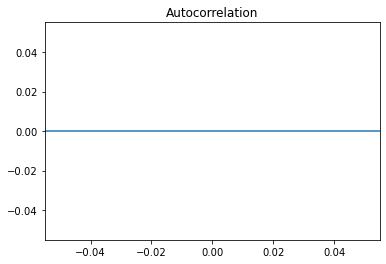

In [11]:
plot_acf(df['newDeaths'], alpha =0.05)
plt.show()

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


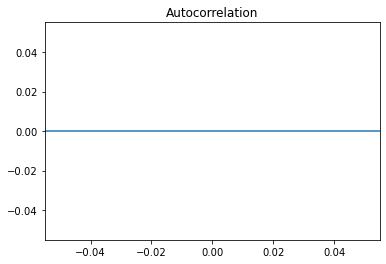

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


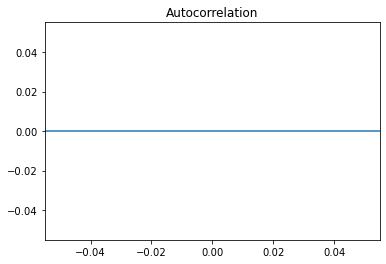

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


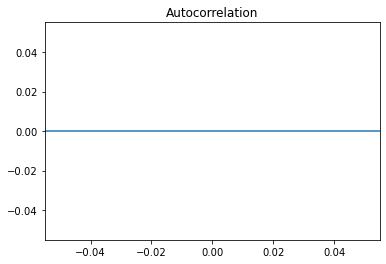

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


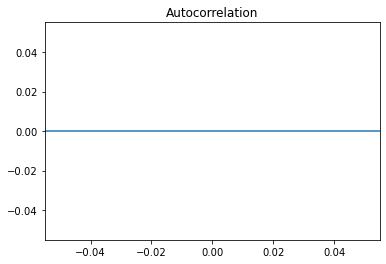

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


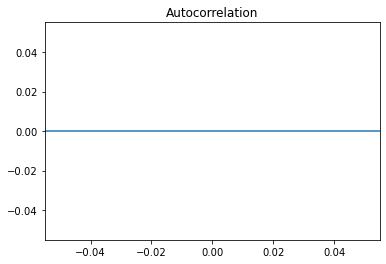

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


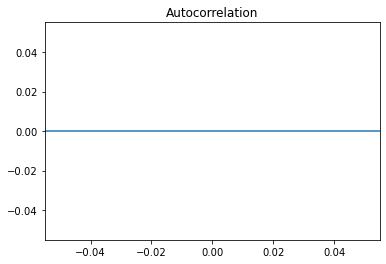

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


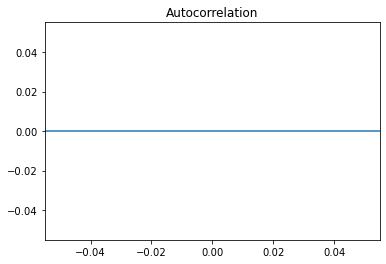

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


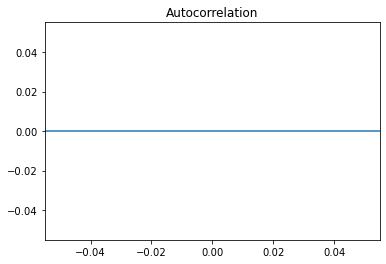

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


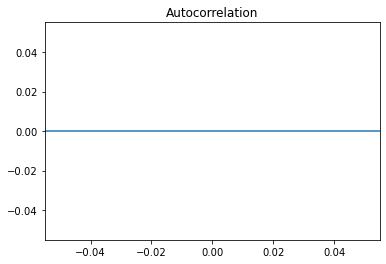

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


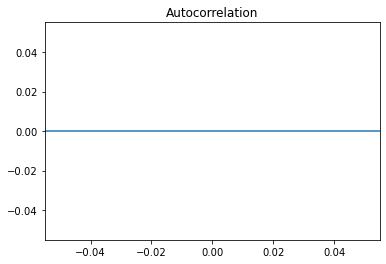

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


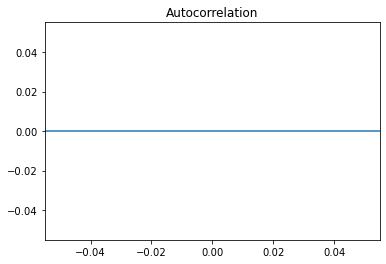

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


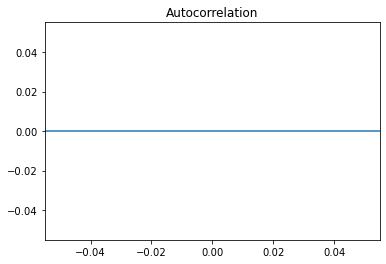

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


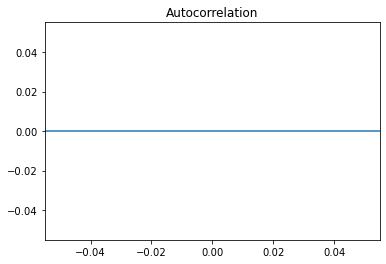

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


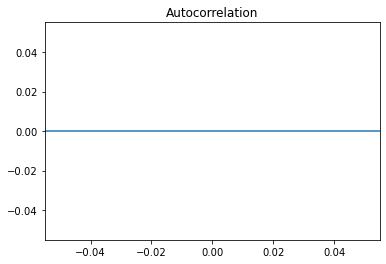

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


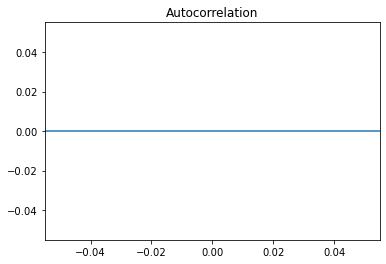

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


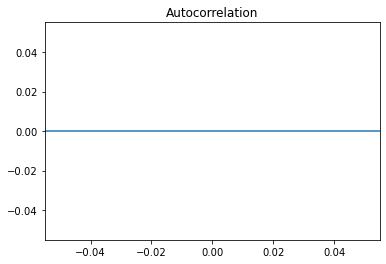

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


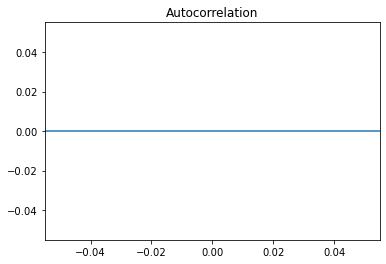

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


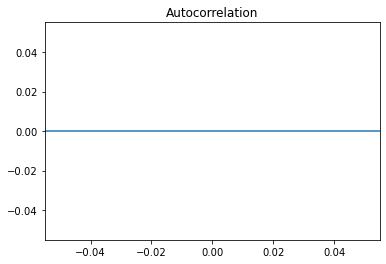

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


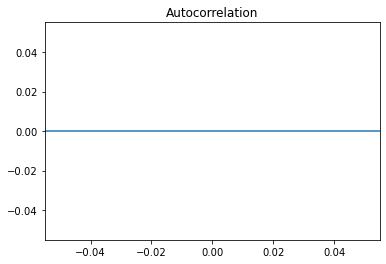

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


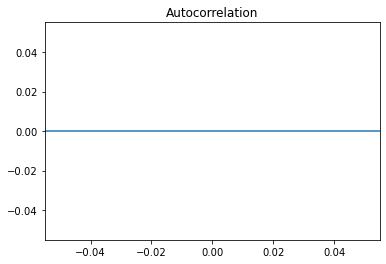

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


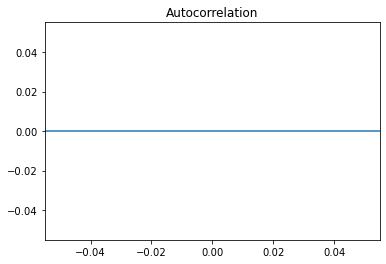

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


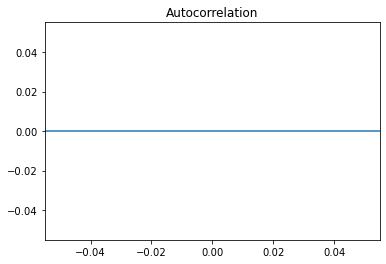

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


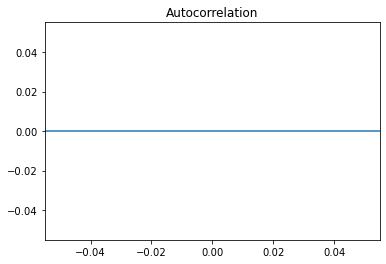

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


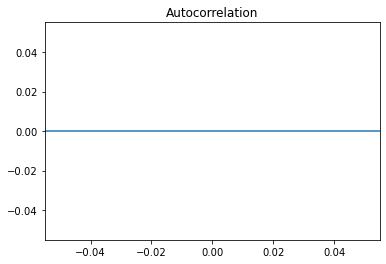

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


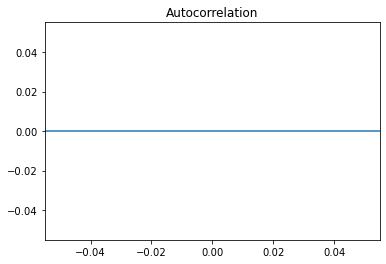

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


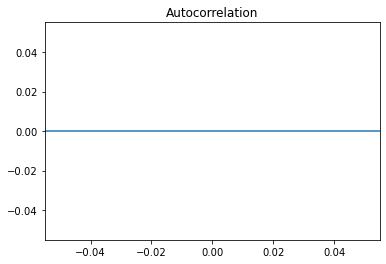

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


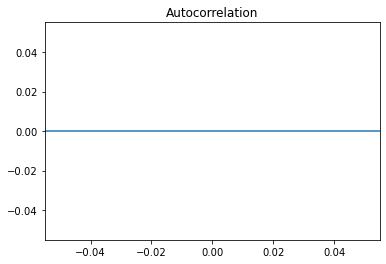

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


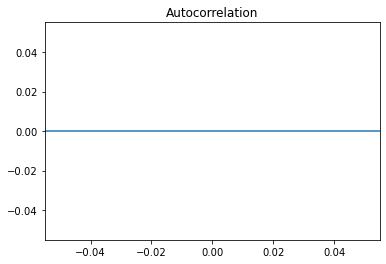

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


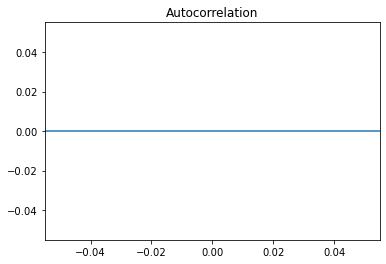

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


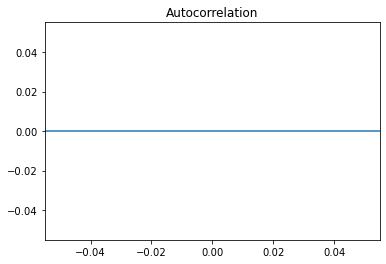

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


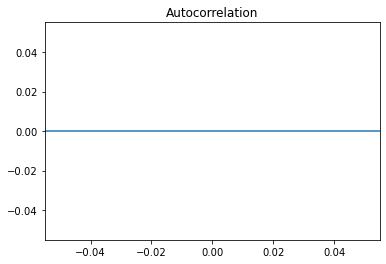

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


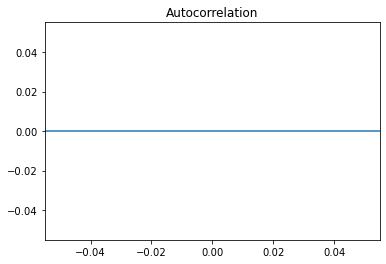

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


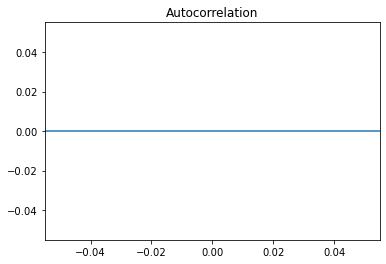

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


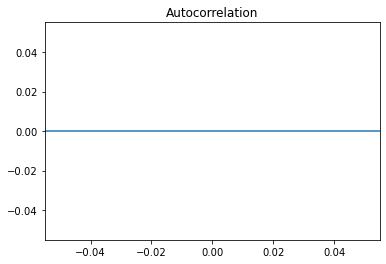

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


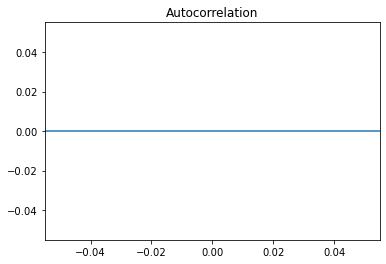

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


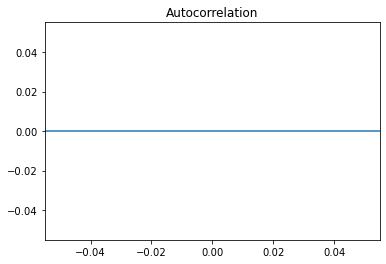

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


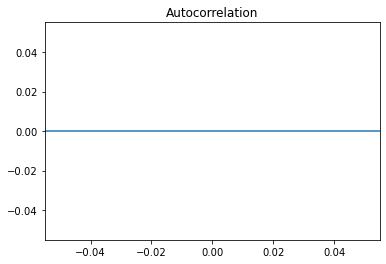

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


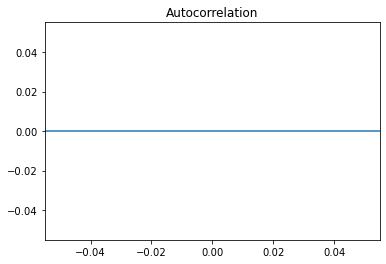

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


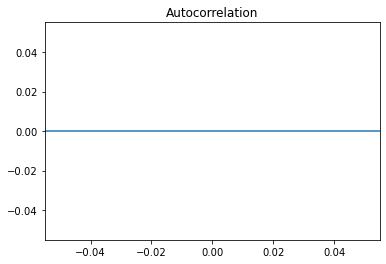

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


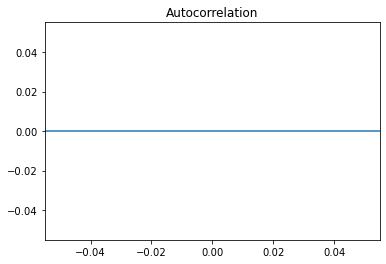

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


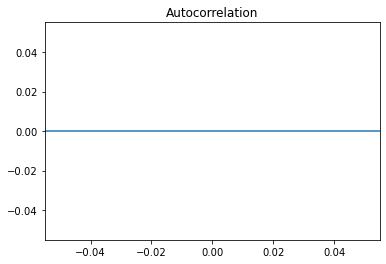

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


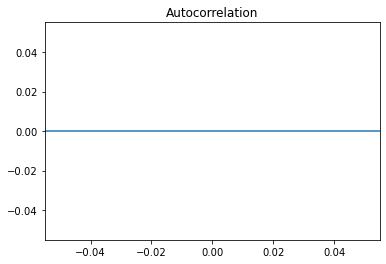

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


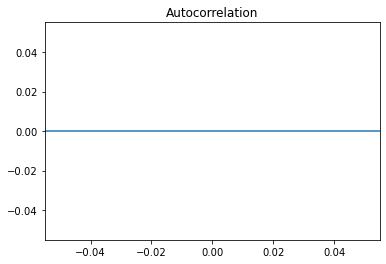

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


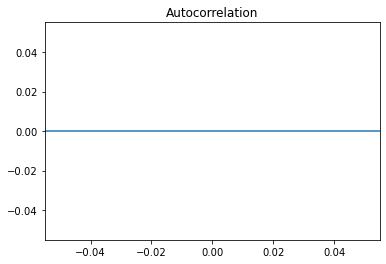

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


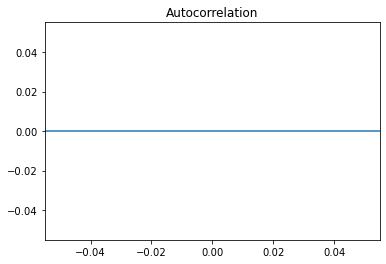

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


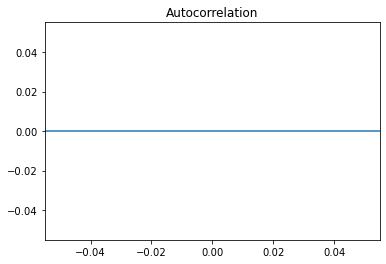

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


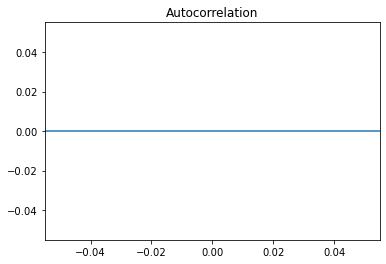

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


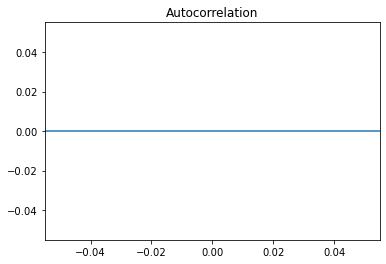

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


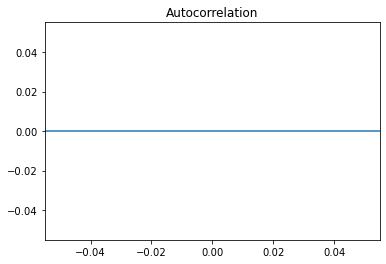

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


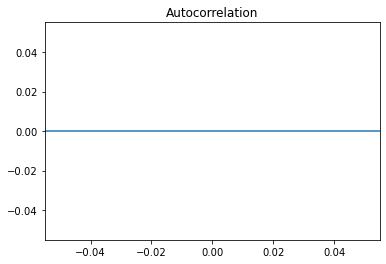

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


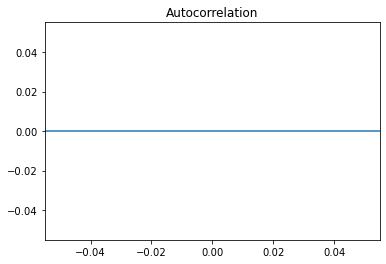

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


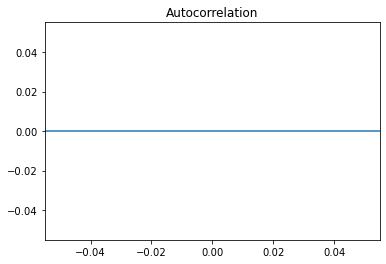

C:\Users\aarme\anaconda3\lib\site-packages\matplotlib\axes\_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


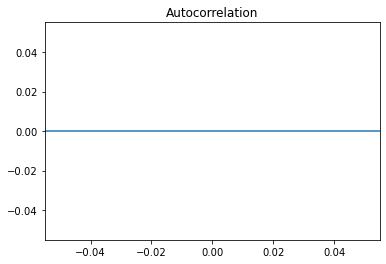

In [5]:
for state in df['state'].unique():
    state_df = df[df['state'] == state]
    plot_acf(state_df['newDeaths'], alpha =0.05)
#     plt.title('state')
    plt.show()

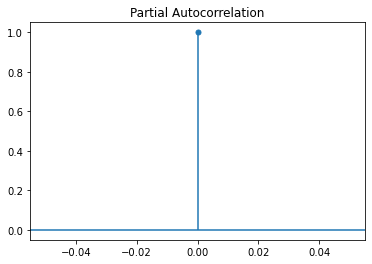

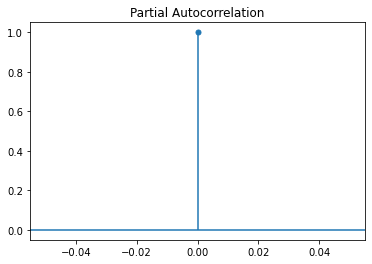

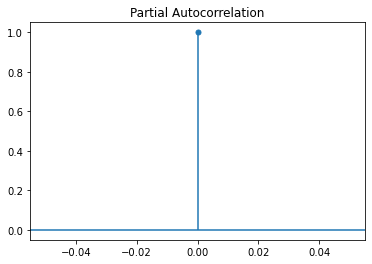

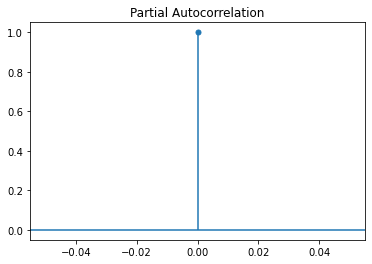

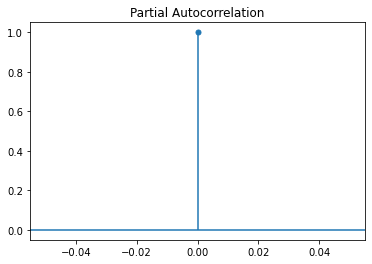

...

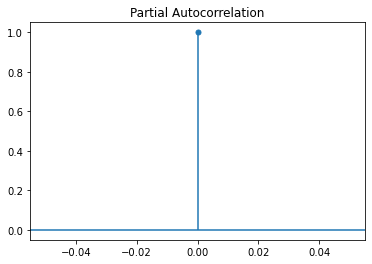

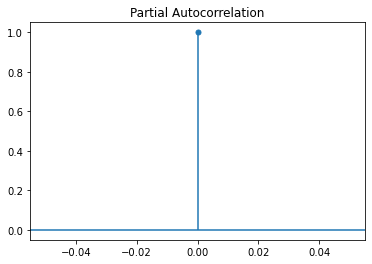

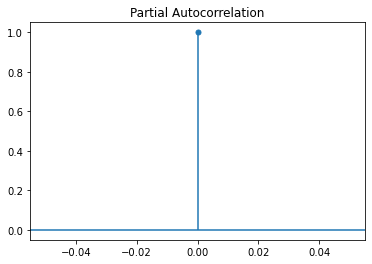

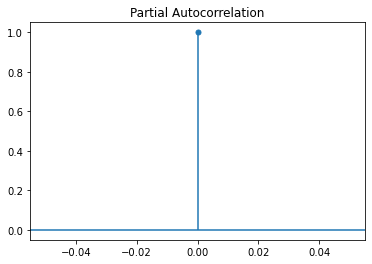

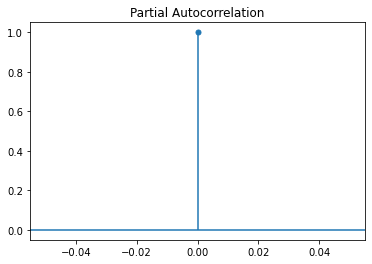

In [6]:
for state in df['state'].unique():
    state_df = df[df['state'] == state]
    plot_pacf(state_df['newDeaths'], alpha =0.05)
#     plt.title('state')
    plt.show()

In [19]:
X =np.arange(len(df[['newDeaths']].dropna()))
Y = np.asarray(df[['newDeaths']].dropna())

X = sm.add_constant(X)

  
# Fit the ordinary least square method.
ols_res = OLS(Y,X).fit()
# apply durbin watson statistic on the ols residual
durbin_watson(ols_res.resid)


0.8953640164958956

In [24]:
for state in df['state'].unique():
    state_df = df[df['state']==state]
    
    X =np.arange(len(state_df[['newDeaths']].dropna()))
   
    Y = np.asarray(state_df[['newDeaths']].dropna())
    X = sm.add_constant(X)

    # Fit the ordinary least square method.
    ols_res = OLS(Y,X).fit()
    # apply durbin watson statistic on the ols residual
    print(state, durbin_watson(ols_res.resid))


AK 1.7638658501860744
AL 1.3509564472162663
AR 1.327202928802562
AZ 1.0550461620838947
CA 0.4240179766661897
CO 1.2507393623457177
CT 0.9976131478427089
DC 0.8389427982111369
DE 1.7933913708609335
FL 1.8165326018521373
GA 1.228410854171183
HI 1.1352523443390317
IA 1.8378058015396612
ID 1.4115830787446557
IL 0.5554181134866301
IN 1.030886376388213
KS 1.8570457421485806
KY 1.5094893681824073
LA 1.2890101913263
MA 0.5279642431333657
MD 0.8488300068393516
ME 1.4776477737597242
MI 1.4707158278105896
MN 0.8611278243569366
MO 1.6118237890557239
MP 2.0088883719930295
MS 1.5363315717779937
MT 1.7863690035470623
NC 1.6143005591758859
ND 1.4996912212100975
NE 1.4925154797019655
NH 1.1859390038433522
NJ 0.6014677473484011
NM 0.9806095219879755
NV 0.705567004337716
NY 0.7602637200221871
OH 1.9250475649068222
OK 1.8917774458491576
OR 1.381552848729792
PA 0.8895786299970065
RI 2.0441656478443497
SC 1.5243830432408625
SD 1.512157950459978
TN 1.4616809754762021
TX 0.6678257532186966
UT 1.21170797991061

In [8]:
df[df['state'] == 'PR']['county']

1712046    Adjuntas Municipio
1712047    Adjuntas Municipio
1712048    Adjuntas Municipio
1712049    Adjuntas Municipio
1712050    Adjuntas Municipio
                  ...        
1769047       Yauco Municipio
1769048       Yauco Municipio
1769049       Yauco Municipio
1769050       Yauco Municipio
1769051       Yauco Municipio
Name: county, Length: 57006, dtype: object

In [33]:
print(len(df))
df.isna().sum()

2322887


Unnamed: 0                                 0
testPositivityRatio                   358079
caseDensity_x                          43288
contactTracerCapacityRatio           2322275
infectionRate                         159819
infectionRateCI90                     159819
icuCapacityRatio                     2185396
date                                       0
vaccinationsInitiatedRatio           1113079
vaccinationsCompletedRatio           1100817
vaccinationsAdditionalDoseRatio      2019543
fips                                       0
country                                    0
state                                      0
county                                     0
level                                      0
lat                                  2322887
locationId                                 0
long                                 2322887
population                                 0
cases                                  59693
deaths                                 57528
positiveTe

In [32]:
for state in df['state'].unique():
    state_df = df[df['state']==state]
    print('***',state,len(state_df),'***')
    print(state_df.isna().sum())

*** AK 21362 ***
Unnamed: 0                               0
testPositivityRatio                   8805
caseDensity_x                          497
contactTracerCapacityRatio           21362
infectionRate                         3002
infectionRateCI90                     3002
icuCapacityRatio                     20756
date                                     0
vaccinationsInitiatedRatio            9283
vaccinationsCompletedRatio            9283
vaccinationsAdditionalDoseRatio      18590
fips                                     0
country                                  0
state                                    0
county                                   0
level                                    0
lat                                  21362
locationId                               0
long                                 21362
population                               0
cases                                 1000
deaths                                 991
positiveTests                        

*** CO 47106 ***
Unnamed: 0                               0
testPositivityRatio                   7128
caseDensity_x                          764
contactTracerCapacityRatio           47106
infectionRate                         6442
infectionRateCI90                     6442
icuCapacityRatio                     44811
date                                     0
vaccinationsInitiatedRatio           21761
vaccinationsCompletedRatio           21469
vaccinationsAdditionalDoseRatio      40770
fips                                     0
country                                  0
state                                    0
county                                   0
level                                    0
lat                                  47106
locationId                               0
long                                 47106
population                               0
cases                                  908
deaths                                 907
positiveTests                        

*** GA 118040 ***
Unnamed: 0                                0
testPositivityRatio                   13632
caseDensity_x                          1420
contactTracerCapacityRatio           118040
infectionRate                          3075
infectionRateCI90                      3075
icuCapacityRatio                     112144
date                                      0
vaccinationsInitiatedRatio            53423
vaccinationsCompletedRatio            51285
vaccinationsAdditionalDoseRatio      102398
fips                                      0
country                                   0
state                                     0
county                                    0
level                                     0
lat                                  118040
locationId                                0
long                                 118040
population                                0
cases                                  2069
deaths                                 2046
positiveTests 

*** IN 68031 ***
Unnamed: 0                               0
testPositivityRatio                    935
caseDensity_x                          540
contactTracerCapacityRatio           68031
infectionRate                         1031
infectionRateCI90                     1031
icuCapacityRatio                     63142
date                                     0
vaccinationsInitiatedRatio           28260
vaccinationsCompletedRatio           28170
vaccinationsAdditionalDoseRatio      58923
fips                                     0
country                                  0
state                                    0
county                                   0
level                                    0
lat                                  68031
locationId                               0
long                                 68031
population                               0
cases                                  847
deaths                                 842
positiveTests                        

*** MD 17814 ***
Unnamed: 0                               0
testPositivityRatio                     10
caseDensity_x                          183
contactTracerCapacityRatio           17814
infectionRate                          203
infectionRateCI90                      203
icuCapacityRatio                     15921
date                                     0
vaccinationsInitiatedRatio            7345
vaccinationsCompletedRatio            7345
vaccinationsAdditionalDoseRatio      15438
fips                                     0
country                                  0
state                                    0
county                                   0
level                                    0
lat                                  17814
locationId                               0
long                                 17814
population                               0
cases                                  179
deaths                                 154
positiveTests                        

*** MP 1299 ***
Unnamed: 0                              0
testPositivityRatio                  1299
caseDensity_x                          14
contactTracerCapacityRatio           1299
infectionRate                          19
infectionRateCI90                      19
icuCapacityRatio                     1299
date                                    0
vaccinationsInitiatedRatio           1299
vaccinationsCompletedRatio           1299
vaccinationsAdditionalDoseRatio      1299
fips                                    0
country                                 0
state                                   0
county                                  0
level                                   0
lat                                  1299
locationId                              0
long                                 1299
population                              0
cases                                  13
deaths                                  0
positiveTests                        1299
negativeTests     

*** NE 68057 ***
Unnamed: 0                               0
testPositivityRatio                  40386
caseDensity_x                         2823
contactTracerCapacityRatio           68057
infectionRate                        22540
infectionRateCI90                    22540
icuCapacityRatio                     66616
date                                     0
vaccinationsInitiatedRatio           30878
vaccinationsCompletedRatio           29750
vaccinationsAdditionalDoseRatio      58850
fips                                     0
country                                  0
state                                    0
county                                   0
level                                    0
lat                                  68057
locationId                               0
long                                 68057
population                               0
cases                                 4077
deaths                                4064
positiveTests                        

*** NY 46426 ***
Unnamed: 0                               0
testPositivityRatio                    235
caseDensity_x                           69
contactTracerCapacityRatio           46426
infectionRate                          634
infectionRateCI90                      634
icuCapacityRatio                     41656
date                                     0
vaccinationsInitiatedRatio           19865
vaccinationsCompletedRatio           19865
vaccinationsAdditionalDoseRatio      40387
fips                                     0
country                                  0
state                                    0
county                                   0
level                                    0
lat                                  46426
locationId                               0
long                                 46426
population                               0
cases                                  511
deaths                                 502
positiveTests                        

*** RI 3690 ***
Unnamed: 0                              0
testPositivityRatio                     0
caseDensity_x                          22
contactTracerCapacityRatio           3690
infectionRate                          55
infectionRateCI90                      55
icuCapacityRatio                     3298
date                                    0
vaccinationsInitiatedRatio           1496
vaccinationsCompletedRatio           1496
vaccinationsAdditionalDoseRatio      3195
fips                                    0
country                                 0
state                                   0
county                                  0
level                                   0
lat                                  3690
locationId                              0
long                                 3690
population                              0
cases                                  52
deaths                                 45
positiveTests                        3690
negativeTests     

*** UT 21555 ***
Unnamed: 0                               0
testPositivityRatio                   2408
caseDensity_x                          273
contactTracerCapacityRatio           21555
infectionRate                         3441
infectionRateCI90                     3441
icuCapacityRatio                     20408
date                                     0
vaccinationsInitiatedRatio            9308
vaccinationsCompletedRatio            9308
vaccinationsAdditionalDoseRatio      18684
fips                                     0
country                                  0
state                                    0
county                                   0
level                                    0
lat                                  21555
locationId                               0
long                                 21555
population                               0
cases                                  890
deaths                                 890
positiveTests                        

*** WV 40519 ***
Unnamed: 0                               0
testPositivityRatio                     71
caseDensity_x                          392
contactTracerCapacityRatio           40519
infectionRate                         1202
infectionRateCI90                     1202
icuCapacityRatio                     38156
date                                     0
vaccinationsInitiatedRatio           18099
vaccinationsCompletedRatio           18099
vaccinationsAdditionalDoseRatio      35569
fips                                     0
country                                  0
state                                    0
county                                   0
level                                    0
lat                                  40519
locationId                               0
long                                 40519
population                               0
cases                                 1093
deaths                                1090
positiveTests                        

In [4]:
from statsmodels.tsa.stattools import adfuller
from numpy import log
for state in df['state'].unique():
    state_df = df[df['state']==state]
    result = adfuller(state_df.newCases.dropna())
    print('ADF Statistic: %f' % result[0])
    print('p-value: %f' % result[1])

ADF Statistic: -13.244858
p-value: 0.000000
ADF Statistic: -20.806376
p-value: 0.000000
ADF Statistic: -21.635984
p-value: 0.000000
ADF Statistic: -9.820568
p-value: 0.000000
ADF Statistic: -19.225817
p-value: 0.000000
ADF Statistic: -15.389119
p-value: 0.000000
ADF Statistic: -8.463719
p-value: 0.000000
ADF Statistic: -3.978412
p-value: 0.001528
ADF Statistic: -4.865761
p-value: 0.000041
ADF Statistic: -19.801274
p-value: 0.000000
ADF Statistic: -27.050942
p-value: 0.000000
ADF Statistic: -7.258226
p-value: 0.000000
ADF Statistic: -18.066314
p-value: 0.000000
ADF Statistic: -15.413318
p-value: 0.000000
ADF Statistic: -21.499993
p-value: 0.000000
ADF Statistic: -21.203481
p-value: 0.000000
ADF Statistic: -20.920812
p-value: 0.000000
ADF Statistic: -23.051133
p-value: 0.000000
ADF Statistic: -22.452440
p-value: 0.000000
ADF Statistic: -10.459230
p-value: 0.000000
ADF Statistic: -14.346049
p-value: 0.000000
ADF Statistic: -9.303860
p-value: 0.000000
ADF Statistic: -21.403032
p-value: 0.0

In [17]:
from pmdarima.arima.utils import ndiffs

y = df.newDeaths.dropna()

## Adf Test
print(ndiffs(y, test='adf'))  # 2

# KPSS test
print(ndiffs(y, test='kpss'))  # 0

# PP test:
print(ndiffs(y, test='pp'))  # 2

0
1
0
